In [2]:
%load_ext autoreload
%autoreload 2

import cv2
import numpy as np
import pandas as pd

import vis_utils

In [3]:
df = pd.read_csv('recruitment_task_pitch_geom/df_keypoints.csv')

In [3]:
df

,x,y,vis,kid,dataset,image_path
0,532,158,2,1,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
1,1732,227,2,2,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
2,0,0,0,3,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
3,0,0,0,4,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
4,359,203,2,5,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
...,...,...,...,...,...,...
160363,0,0,0,35,test,images/test/1a086eda9797612fa9c24b38cd94fc.jpg
160364,0,0,0,36,test,images/test/1a086eda9797612fa9c24b38cd94fc.jpg
160365,0,0,0,37,test,images/test/1a086eda9797612fa9c24b38cd94fc.jpg
160366,0,0,0,38,test,images/test/1a086eda9797612fa9c24b38cd94fc.jpg


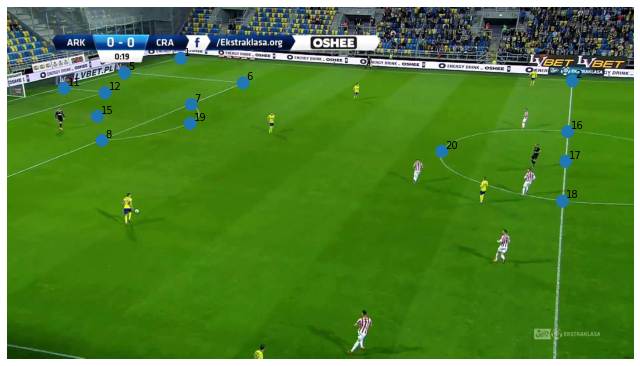

In [30]:
vis_utils.show_image_with_annotations(img_path='images/train/c814ce8e31e077df861c2848fe14fb.jpg', df=df)

# Statystyki występowania keypointów

In [61]:
print(f'There is {df["kid"].nunique()} different keypoints')

There is 39 different keypoints


## Procent widocznych keypointów na klatkach

In [31]:
df.columns

Index(['x', 'y', 'vis', 'kid', 'dataset', 'image_path'], dtype='object')

In [46]:
df['vis'] = df['vis'].apply(lambda x: 1 if x == 2 else 0)

In [47]:
df_train = df[df['dataset'] == 'train']

Average 0.0 means that there are not visible keypoints at the frame and 1.0 means that every keypoint is visible

In [58]:
visibility_percent = df_train.groupby('image_path')['vis'].mean()

Surprisingly there is are frames from the train set with not visible keypoints!

In [62]:
39 * 0.641026

25.000014

In [72]:
df[df['image_path'].isin(visibility_percent[visibility_percent == 0.0].index)]

,x,y,vis,kid,dataset,image_path
90012,0,0,0,1,train,images/train/0f3a9b662ce6b59b067bc3b2b97182.jpg
90013,0,0,0,2,train,images/train/0f3a9b662ce6b59b067bc3b2b97182.jpg
90014,0,0,0,3,train,images/train/0f3a9b662ce6b59b067bc3b2b97182.jpg
90015,0,0,0,4,train,images/train/0f3a9b662ce6b59b067bc3b2b97182.jpg
90016,0,0,0,5,train,images/train/0f3a9b662ce6b59b067bc3b2b97182.jpg
...,...,...,...,...,...,...
135013,0,0,0,35,train,images/train/2a30fa43f48897e8dfb17eabbecf0d.jpg
135014,0,0,0,36,train,images/train/2a30fa43f48897e8dfb17eabbecf0d.jpg
135015,0,0,0,37,train,images/train/2a30fa43f48897e8dfb17eabbecf0d.jpg
135016,0,0,0,38,train,images/train/2a30fa43f48897e8dfb17eabbecf0d.jpg


Maximal visibility is 64% of visible keypoints, which is 25 out of 39

In [60]:
visibility_percent.sort_values(ascending=False)[:5]

image_path
images/train/30e04c17a2dcbba29f0317f319af89.jpg    0.641026
images/train/a802c893e1fb74366289b305bbfd1a.jpg    0.641026
images/train/761ee7f3545814a4e469f1191214ca.jpg    0.641026
images/train/73c2ca96a05c549a950371facf86c6.jpg    0.641026
images/train/42409df602ba6029113c5711310ee3.jpg    0.641026
Name: vis, dtype: float64

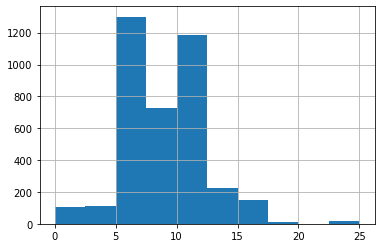

In [70]:
visibility_sum = df_train.groupby('image_path')['vis'].sum()
_ = visibility_sum.hist()

In [71]:
visibility_sum.mean()

8.761119832548404

### Plot frames which no visible keypoints

In [ ]:
df[df['image_path'].isin(visibility_percent[visibility_percent == 0.0].index)]

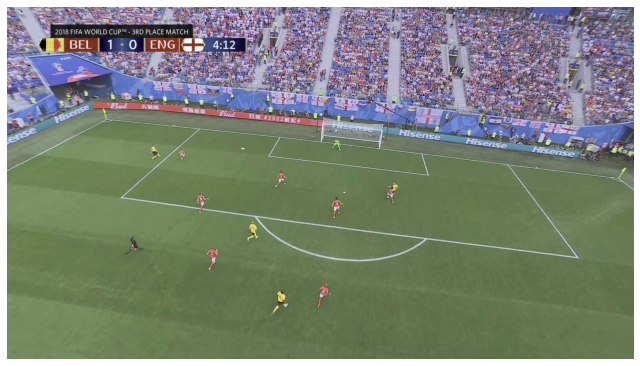

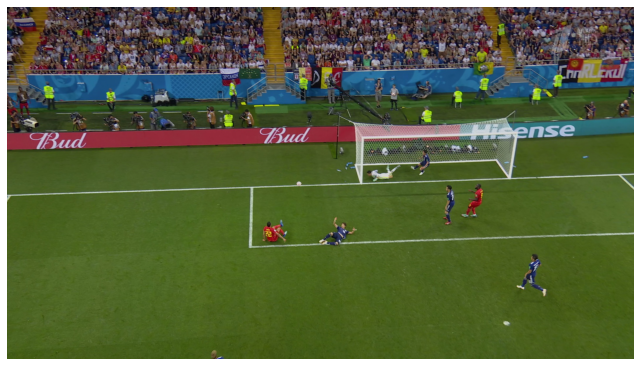

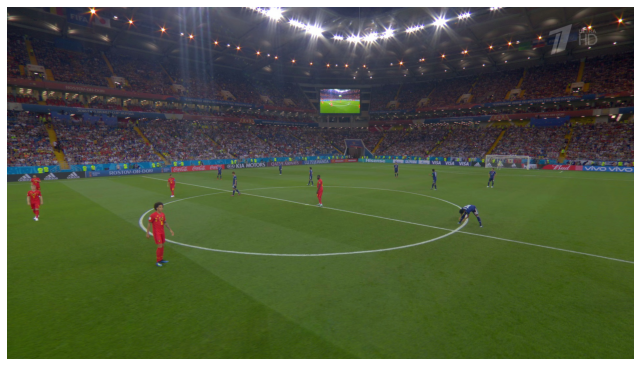

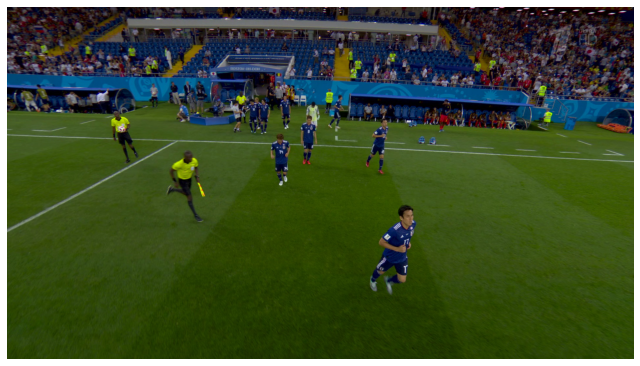

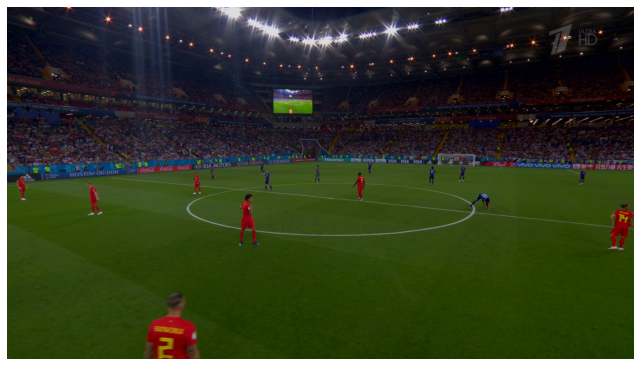

...

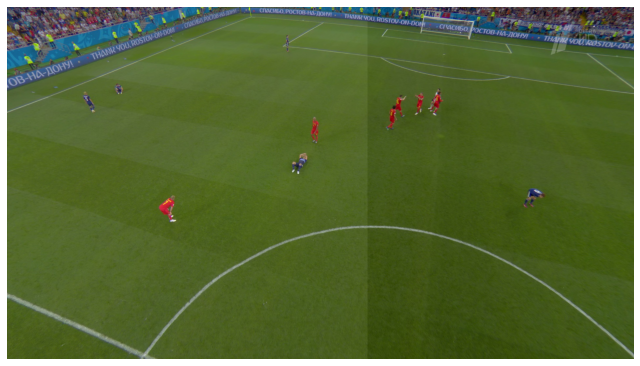

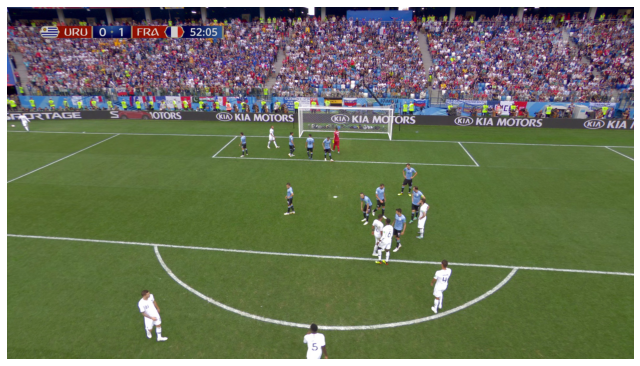

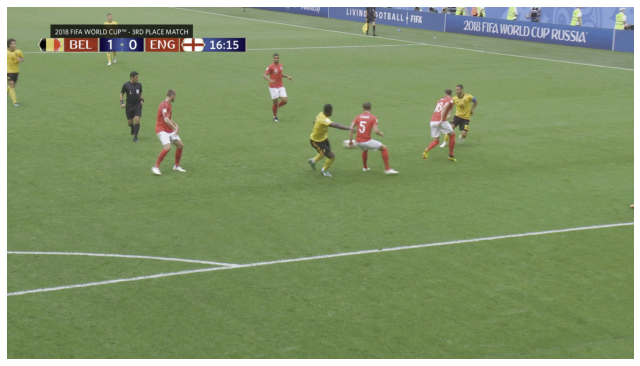

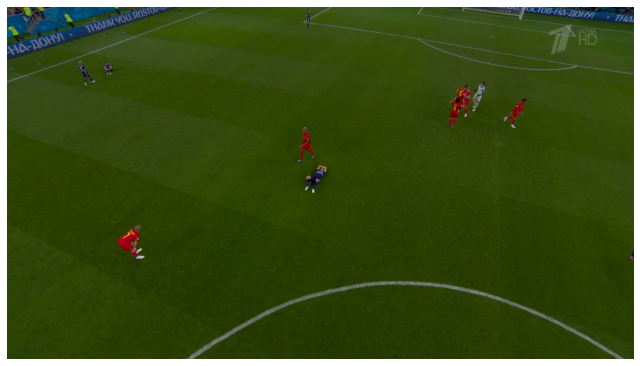

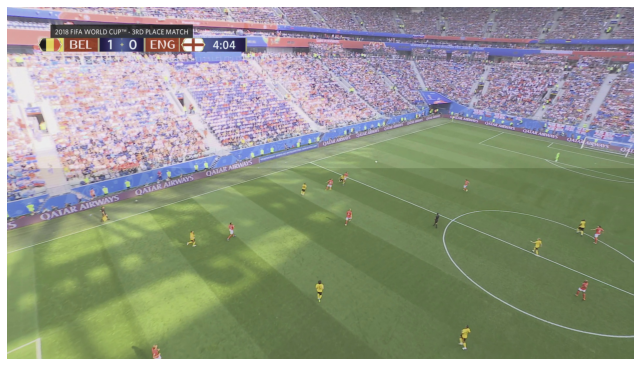

In [76]:
for img_path in visibility_percent[visibility_percent == 0.0].index:
    assert df[df['image_path'] == img_path]['dataset'].unique() == 'train'
    vis_utils.show_image_with_annotations(img_path=img_path, df=df)

Lepiej odfiltrować te zdjęcia przed treningiem

## Jakie keypointy występują najczęściej?

In [78]:
df_train[df_train['vis'] != 0]['kid'].value_counts()

17    1989
16    1978
18    1956
2     1910
20    1877
21    1837
6     1311
19    1234
7     1219
26    1208
39    1106
1     1076
27    1074
8     1019
5      991
12     962
15     944
22     939
28     889
25     856
32     854
35     826
11     819
31     728
9      644
13     584
4      570
29     567
33     550
14     404
34     356
10     150
23      34
3       23
38       1
Name: kid, dtype: int64

Jak można się było domyślić, punkty ze środka boiska (20, 16, 21, 18, 17) występują najczęściej. Co jednak ciekawe, równie często występuje punkt 2, zaś odpowiadający mu punkt po przeciwległej stronie boiska występuje ponad 3 razy rzadziej.

It looks as if the point with a label 38 was mistaken with 39. You can also see that there is no keypoint '24' and '30'.

In [84]:
df.query('kid == 38 and vis != 0')['image_path']

1675    images/train/a4aae193d810ebde815016b779f0f0.jpg
Name: image_path, dtype: object

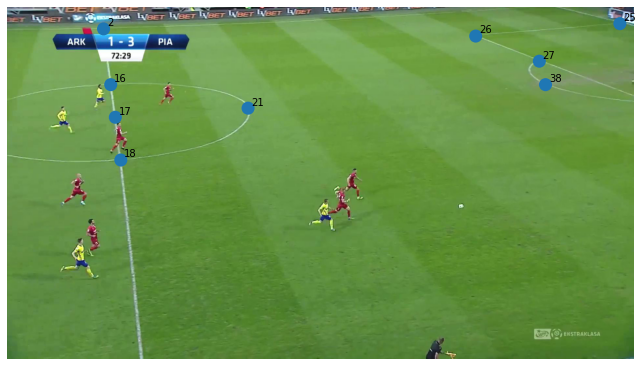

In [86]:
img_path = df.query('kid == 38 and vis != 0')['image_path'].item()
vis_utils.show_image_with_annotations(img_path=img_path, df=df)

In [5]:
df

,x,y,vis,kid,dataset,image_path
0,532,158,2,1,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
1,1732,227,2,2,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
2,0,0,0,3,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
3,0,0,0,4,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
4,359,203,2,5,train,images/train/c814ce8e31e077df861c2848fe14fb.jpg
...,...,...,...,...,...,...
160363,0,0,0,35,test,images/test/1a086eda9797612fa9c24b38cd94fc.jpg
160364,0,0,0,36,test,images/test/1a086eda9797612fa9c24b38cd94fc.jpg
160365,0,0,0,37,test,images/test/1a086eda9797612fa9c24b38cd94fc.jpg
160366,0,0,0,38,test,images/test/1a086eda9797612fa9c24b38cd94fc.jpg


This image should contain the keypoint '30', but it doesn't!

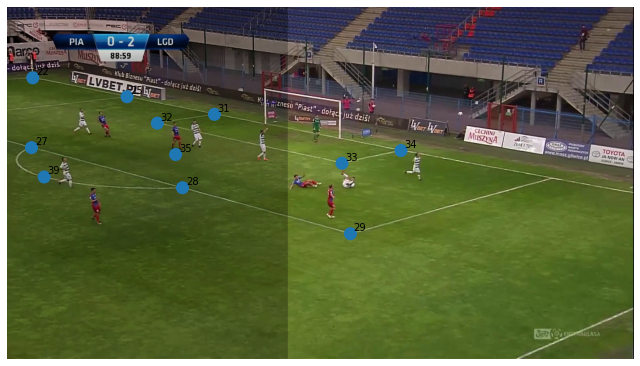

In [8]:
img_path = 'images/train/0d0365deb03c4703e978f360d5ff72.jpg'
vis_utils.show_image_with_annotations(img_path=img_path, df=df)

# Corner detection

## Harris Corner Detection

URL: https://opencv24-python-tutorials.readthedocs.io/en/stable/py_tutorials/py_feature2d/py_features_harris/py_features_harris.html

In [91]:
import matplotlib.pyplot as plt

In [96]:
filename = 'recruitment_task_pitch_geom/images/train/c814ce8e31e077df861c2848fe14fb.jpg'

img = cv2.imread(filename)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

gray = np.float32(gray)
dst = cv2.cornerHarris(gray,2,3,0.04)

#result is dilated for marking the corners, not important
dst = cv2.dilate(dst, None)

# Threshold for an optimal value, it may vary depending on the image.
img[dst > 0.01 * dst.max()] = [0, 0, 255]

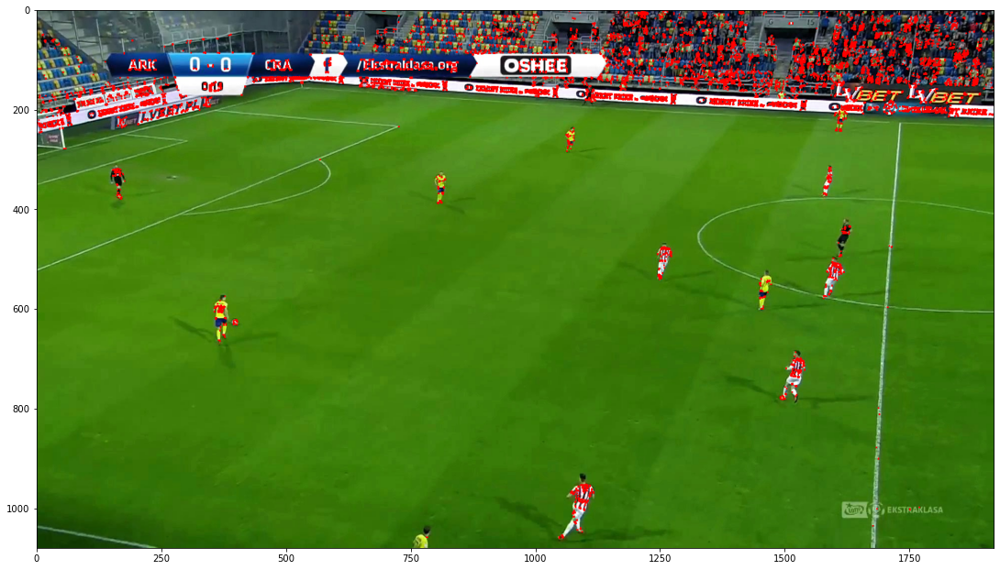

In [97]:
fig, ax = plt.subplots(1, figsize=(19.20, 10.80))
ax.imshow(img[:, :, ::-1])
plt.show()

## Shi-Tomasi Corner Detector & Good Features to Track

URL: https://opencv24-python-tutorials.readthedocs.io/en/stable/py_tutorials/py_feature2d/py_shi_tomasi/py_shi_tomasi.html
It chooses $N$ best corners, while in my case the keypoints are not necesarily the best corners, so probably I shoudn't use it.

## SIFT (Scale-Invariant Feature Transform)

This algorithm could be great in general but im y special case I don't need to be scalae invariant. It would be even better to not be scale invariant and detect only small corners.

## Canny edge detector

URL: https://opencv24-python-tutorials.readthedocs.io/en/stable/py_tutorials/py_imgproc/py_canny/py_canny.html#canny

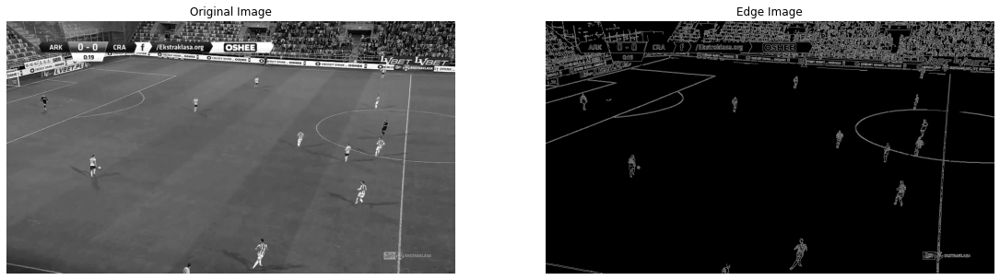

In [108]:
img = cv2.imread(filename, 0)
# gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
# gray = np.float32(gray)
edges = cv2.Canny(img, 100, 200)

fig, ax = plt.subplots(1, 2, figsize=(19.20, 10.80))
ax[0].imshow(img, cmap = 'gray')
ax[0].set_title('Original Image'), 
ax[0].axis('off')

ax[1].imshow(edges,cmap = 'gray')
ax[1].set_title('Edge Image'), 
ax[1].axis('off')

plt.show()